In [1]:
import numpy as np
import pandas as pd
from scipy.interpolate import make_interp_spline
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.patches as mpatches
import zipfile

In [2]:
vestiaire_path = '/Users/acadiagrenier/Desktop/FallFiles.2024/DNSC4211/vestiaire.csv.zip'

In [3]:
#-- Used to load zip onto local host: https://unc-libraries-data.github.io/Python/Files_Packages/Files_Packages.html
with zipfile.ZipFile(vestiaire_path, 'r') as zip_ref:
    vestiaire_df = zip_ref.namelist()[0] 
    with zip_ref.open(vestiaire_df) as vestiaire_df:
        vestiaire_data = pd.read_csv(vestiaire_df)


In [4]:
#-- I am trying to convey to Vestiaire Stakeholders that they need to leverage two things:
# 1. What products are preferred by customers, that way they can target specific brands/item types to increase revenue
# 2. And that by selling high quality products that match consumer wants, Vestiaire can help reduce textile waste among the most wasteful class, better acheiving their goal of sustainable fashion

In [5]:
#1. Cleaning

In [6]:
vestiaire_data.head(5)

,product_id,product_type,product_name,product_description,product_keywords,product_gender_target,product_category,product_season,product_condition,product_like_count,...,warehouse_name,seller_id,seller_username,usually_ships_within,seller_country,seller_products_sold,seller_num_products_listed,seller_community_rank,seller_num_followers,seller_pass_rate
0,43247626,Wool mini skirt,Wool mini skirt Miu Miu Grey size S Internatio...,Miu Miu – Pleated mini skirt Size: 36 (S) Wai...,Miu Miu Wool Skirts,Women,Women Clothing,Autumn / Winter,Never worn,34.0,...,Tourcoing,25775970,vitalii25775970,NaN,Germany,3.0,14.0,0.0,13.0,0.0
1,43247441,Jacket,Jacket Barbara Bui Navy size 42 FR in Cotton,For selling nice women's suit Barbara Bui size...,Barbara Bui Cotton Jackets,Women,Women Clothing,All seasons,Very good condition,1.0,...,Tourcoing,13698770,olivia13698770,NaN,Belgium,0.0,0.0,0.0,8.0,0.0
2,43246517,Wool coat,Wool coat Comme Des Garcons White size S Inter...,Magnificent boiled wool coat. I bought it in t...,Comme Des Garcons Wool Coats,Women,Women Clothing,Autumn / Winter,Very good condition,2.0,...,Tourcoing,6042365,cecilia6042365,1-2 days,Spain,58.0,69.0,0.0,62.0,96.0
3,43246507,Mini skirt,Mini skirt MSGM Black size 38 IT in Polyester,MSGM Skirt Black Printed Raw-Edge & Embroidere...,MSGM Polyester Skirts,Women,Women Clothing,All seasons,Very good condition,0.0,...,Brooklyn,13172949,gretchen13172949,1-2 days,United States,63.0,274.0,126346.0,131.0,96.0
4,43246417,Vegan leather trousers,Vegan leather trousers LVIR Black size 36 FR i...,LVIR black grained faux leather trousers size ...,LVIR Vegan leather Trousers,Women,Women Clothing,All seasons,Very good condition,1.0,...,Crawley,2578605,crunchykat,3-5 days,United Kingdom,19.0,14.0,102821.0,40.0,89.0


In [7]:
#Checked to see the data quality -- Missing data = 20.51%
(vestiaire_data.isna().mean() * 100).sum()

20.50850958452617

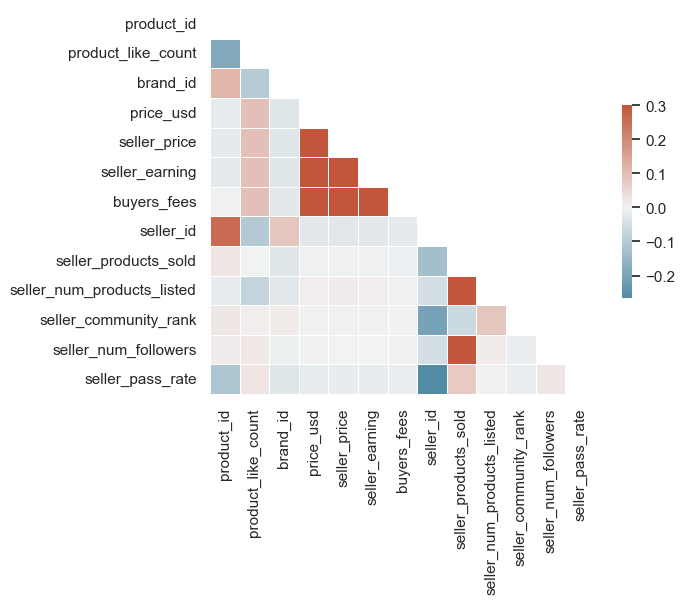

In [8]:
import pandas as pd 
from string import ascii_letters

#--Only used numeric columns,  structure from class 9
#-- corr. is as expected, positively crrelated items make sense, didn't flag anything
vest_num = vestiaire_data.select_dtypes(include=[float, int])
sns.set_theme(style="white")
corr = vest_num.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(7, 5))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})
plt.show()

In [9]:
#900514 rows × 36 columns
pd.set_option('display.max_columns', None)
vestiaire_data

,product_id,product_type,product_name,product_description,product_keywords,product_gender_target,product_category,product_season,product_condition,product_like_count,sold,reserved,available,in_stock,should_be_gone,brand_id,brand_name,brand_url,product_material,product_color,price_usd,seller_price,seller_earning,seller_badge,has_cross_border_fees,buyers_fees,warehouse_name,seller_id,seller_username,usually_ships_within,seller_country,seller_products_sold,seller_num_products_listed,seller_community_rank,seller_num_followers,seller_pass_rate
0,43247626,Wool mini skirt,Wool mini skirt Miu Miu Grey size S Internatio...,Miu Miu – Pleated mini skirt Size: 36 (S) Wai...,Miu Miu Wool Skirts,Women,Women Clothing,Autumn / Winter,Never worn,34.0,True,False,True,False,False,117,Miu Miu,http://vestiairecollective.com/miu-miu/,Wool,Grey,272.92,223.65,216.94,Common,NaN,NaN,Tourcoing,25775970,vitalii25775970,NaN,Germany,3.0,14.0,0.0,13.0,0.0
1,43247441,Jacket,Jacket Barbara Bui Navy size 42 FR in Cotton,For selling nice women's suit Barbara Bui size...,Barbara Bui Cotton Jackets,Women,Women Clothing,All seasons,Very good condition,1.0,False,False,True,False,False,161,Barbara Bui,http://vestiairecollective.com/barbara-bui/,Cotton,Navy,127.80,106.50,106.50,Common,True,21.30,Tourcoing,13698770,olivia13698770,NaN,Belgium,0.0,0.0,0.0,8.0,0.0
2,43246517,Wool coat,Wool coat Comme Des Garcons White size S Inter...,Magnificent boiled wool coat. I bought it in t...,Comme Des Garcons Wool Coats,Women,Women Clothing,Autumn / Winter,Very good condition,2.0,False,False,True,False,False,391,Comme Des Garcons,http://vestiairecollective.com/comme-des-garcons/,Wool,White,1278.00,1065.00,926.55,Expert,True,213.00,Tourcoing,6042365,cecilia6042365,1-2 days,Spain,58.0,69.0,0.0,62.0,96.0
3,43246507,Mini skirt,Mini skirt MSGM Black size 38 IT in Polyester,MSGM Skirt Black Printed Raw-Edge & Embroidere...,MSGM Polyester Skirts,Women,Women Clothing,All seasons,Very good condition,0.0,False,False,True,False,False,2797,MSGM,http://vestiairecollective.com/msgm/,Polyester,Black,163.90,149.00,126.65,Expert,True,14.90,Brooklyn,13172949,gretchen13172949,1-2 days,United States,63.0,274.0,126346.0,131.0,96.0
4,43246417,Vegan leather trousers,Vegan leather trousers LVIR Black size 36 FR i...,LVIR black grained faux leather trousers size ...,LVIR Vegan leather Trousers,Women,Women Clothing,All seasons,Very good condition,1.0,False,False,True,False,False,11956,LVIR,http://vestiairecollective.com/lvir/,Vegan leather,Black,119.72,99.77,83.55,Common,True,19.95,Crawley,2578605,crunchykat,3-5 days,United Kingdom,19.0,14.0,102821.0,40.0,89.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
900509,41538360,Glitter trainers,Glitter trainers Bally Gold size 38 EU in Glit...,"Bally Vita Parcours sneakers. PPleather, suede...",Bally Glitter Trainers,Women,Women Shoes,All seasons,Good condition,1.0,False,False,True,False,False,290,Bally,http://vestiairecollective.com/bally/,Glitter,Gold,89.46,74.55,60.71,Expert,True,14.91,Tourcoing,8849230,lauragua,1-2 days,Italy,40.0,17.0,391778.0,104.0,100.0
900510,41532271,Leather heels,Leather heels Casadei Black size 38.5 EU in Le...,Trendy and classic Casadei high-heel pumps Mad...,Casadei Leather Heels,Women,Women Shoes,All seasons,Good condition,1.0,False,False,True,False,False,1053,Casadei,http://vestiairecollective.com/casadei/,Leather,Black,153.36,127.80,108.63,Expert,True,25.56,Tourcoing,5448248,bettina5448248,1-2 days,Austria,26.0,99.0,51408.0,75.0,89.0
900511,41538140,Leather cowboy boots,Leather cowboy boots Ash Black size 36 EU in L...,Very good quality leather boots Worn once Elas...,Ash Leather Boots,Women,Women Shoes,All seasons,Very good condition,0.0,False,False,True,False,False,206,Ash,http://vestiairecollective.com/ash/,Leather,Black,191.70,159.75,138.98,Common,True,31.95,Tourcoing,9347694,sylvie9347694,NaN,France,0.0,2.0,0.0,3.0,0.0
90051

In [10]:
print(vestiaire_data.columns)

Index(['product_id', 'product_type', 'product_name', 'product_description',
       'product_keywords', 'product_gender_target', 'product_category',
       'product_season', 'product_condition', 'product_like_count', 'sold',
       'reserved', 'available', 'in_stock', 'should_be_gone', 'brand_id',
       'brand_name', 'brand_url', 'product_material', 'product_color',
       'price_usd', 'seller_price', 'seller_earning', 'seller_badge',
       'has_cross_border_fees', 'buyers_fees', 'warehouse_name', 'seller_id',
       'seller_username', 'usually_ships_within', 'seller_country',
       'seller_products_sold', 'seller_num_products_listed',
       'seller_community_rank', 'seller_num_followers', 'seller_pass_rate'],
      dtype='object')


In [11]:
#Removing unnecessary variables that don't impact my analysis

#certain columns contain inconsistent data, the descriptive columns are inconsistent as the seller is coming up with them
#NOT a Vestiaire standardzied description
vestiaire_data = vestiaire_data.drop(columns=['product_id', 'product_description','product_name','product_keywords','product_gender_target','product_season','available','in_stock','should_be_gone','brand_url','product_color','price_usd','seller_earning','seller_badge','has_cross_border_fees','warehouse_name','seller_id','seller_username','usually_ships_within','seller_country','seller_products_sold','seller_num_products_listed','seller_community_rank','seller_num_followers','reserved','seller_pass_rate'])

In [12]:
vestiaire_data.head()

,product_type,product_category,product_condition,product_like_count,sold,brand_id,brand_name,product_material,seller_price,buyers_fees
0,Wool mini skirt,Women Clothing,Never worn,34.0,True,117,Miu Miu,Wool,223.65,NaN
1,Jacket,Women Clothing,Very good condition,1.0,False,161,Barbara Bui,Cotton,106.50,21.30
2,Wool coat,Women Clothing,Very good condition,2.0,False,391,Comme Des Garcons,Wool,1065.00,213.00
3,Mini skirt,Women Clothing,Very good condition,0.0,False,2797,MSGM,Polyester,149.00,14.90
4,Vegan leather trousers,Women Clothing,Very good condition,1.0,False,11956,LVIR,Vegan leather,99.77,19.95


In [13]:
#First I found most purchased brands, product types, quality, and materials
#Goal is to find which ones generate the most sales and then find what brands sell the most inventory
#Gives insight into preferences and products to increase inventory of

In [14]:
vestiaire_data['sold'] = vestiaire_data['sold'].astype(int)

In [15]:
vestiaire_data.head()

,product_type,product_category,product_condition,product_like_count,sold,brand_id,brand_name,product_material,seller_price,buyers_fees
0,Wool mini skirt,Women Clothing,Never worn,34.0,1,117,Miu Miu,Wool,223.65,NaN
1,Jacket,Women Clothing,Very good condition,1.0,0,161,Barbara Bui,Cotton,106.50,21.30
2,Wool coat,Women Clothing,Very good condition,2.0,0,391,Comme Des Garcons,Wool,1065.00,213.00
3,Mini skirt,Women Clothing,Very good condition,0.0,0,2797,MSGM,Polyester,149.00,14.90
4,Vegan leather trousers,Women Clothing,Very good condition,1.0,0,11956,LVIR,Vegan leather,99.77,19.95


In [16]:
total_brand_count = vestiaire_data.groupby('brand_name').size().sort_values(ascending=False)
print(total_brand_count)

brand_name
Gucci              41009
Burberry           24018
Dolce & Gabbana    22024
Prada              20972
Hermès             18711
                   ...  
KANTIS                 1
Sevan Bicakci          1
KLEINFELD              1
Kaaskas                1
Ølaf                   1
Length: 8884, dtype: int64


In [17]:
sold_products = vestiaire_data[vestiaire_data['sold'] == 1]
brand_counts = sold_products['brand_name'].value_counts()
brand_counts

brand_name
Gucci            853
Prada            527
Hermès           348
Burberry         338
Chanel           329
                ... 
Rozae Nichols      1
Wicked Weasel      1
Neve & Noor        1
Dodo Bar Or        1
Ninamounah         1
Name: count, Length: 1461, dtype: int64

In [18]:
#knowing Gucci is the most purchased brand, I wanted to find the % sold of total inventory to see if that metric is from popularity, or because gucci has the largest inventory
#Used the same strategy my group used in ASSN4
total_counts = vestiaire_data.groupby('brand_name').size()
brand_counts = sold_products['brand_name'].value_counts()

selling_rate = brand_counts / total_counts
selling_rate = selling_rate.fillna(0)
selling_rate = selling_rate.reset_index(name='Selling Rate')

selling_rate = selling_rate.sort_values(by='Selling Rate', ascending=False)
selling_rate

,brand_name,Selling Rate
2895,Freda Banana,1.0
3749,It's All About Romance,1.0
8728,ZEUS+DIONE,1.0
8738,Zanini,1.0
3875,James Smith & Sons,1.0
...,...,...
3242,Griffin,0.0
3241,Greymer,0.0
3240,Grey Mer,0.0
3239,Grey Ant,0.0


In [19]:
#I wanted to find the CI for each rate, but all the strategies I tried wouldn't work--I think because there are too many brands with too little data
#now i am going to only use the top 25 brands

In [20]:
#Most sold brands
sold_products = vestiaire_data[vestiaire_data['sold'] == 1]
brand_counts = sold_products['brand_name'].value_counts()
top_25_brands = brand_counts.nlargest(25)

print(top_25_brands.index)

Index(['Gucci', 'Prada', 'Hermès', 'Burberry', 'Chanel', 'Louis Vuitton',
       'Balenciaga', 'Dolce & Gabbana', 'Christian Louboutin', 'Saint Laurent',
       'Valentino Garavani', 'Dior', 'Versace', 'Polo Ralph Lauren',
       'Alexander McQueen', 'Adidas', 'Celine', 'Bottega Veneta', 'Jimmy Choo',
       'Miu Miu', 'Sandro', 'Golden Goose', 'Fendi', 'Acne Studios',
       'Dsquared2'],
      dtype='object', name='brand_name')


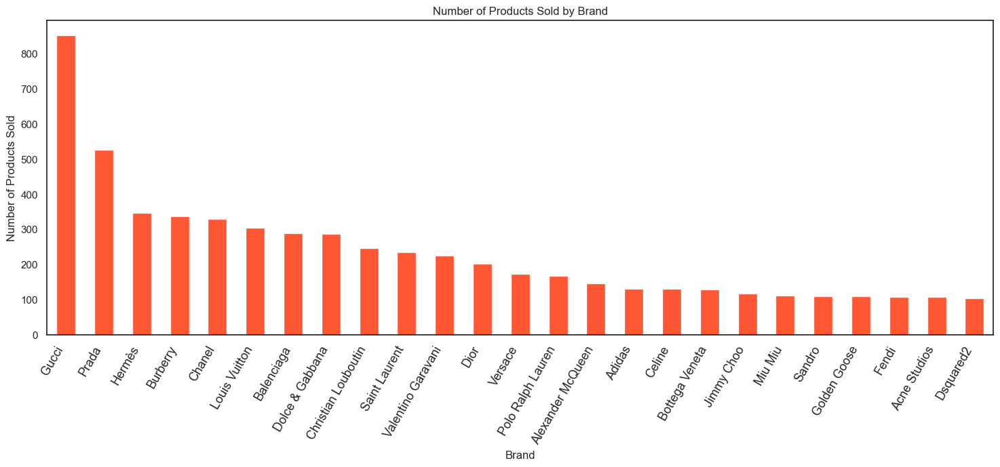

In [21]:
plt.figure(figsize=(18, 8))
plt.subplots_adjust(bottom=0.3)
top_25_brands = brand_counts.nlargest(25)
top_25_brands.plot(kind='bar', color='#FF5733') 
plt.xlabel('Brand')
plt.ylabel('Number of Products Sold')
plt.title('Number of Products Sold by Brand')
plt.xticks(rotation=60, ha='right', fontsize=13)
plt.show()

In [22]:
#Create a column that indicates top brands, allows me to clean out all the smaller brands with less data, makes my data less noisy
top_25_brands = ['Gucci', 'Prada', 'Hermès', 'Burberry', 'Chanel', 'Louis Vuitton',
                 'Balenciaga', 'Dolce & Gabbana', 'Christian Louboutin', 'Saint Laurent',
                 'Valentino Garavani', 'Dior', 'Versace', 'Polo Ralph Lauren',
                 'Alexander McQueen', 'Adidas', 'Celine', 'Bottega Veneta', 'Jimmy Choo',
                 'Miu Miu', 'Sandro', 'Golden Goose', 'Fendi', 'Acne Studios',
                 'Dsquared2']

vestiaire_data['top_25_brand'] = vestiaire_data['brand_name'].isin(top_25_brands).astype(int)

In [23]:
#Same steps but for product type
sold_products = vestiaire_data[vestiaire_data['sold'] == 1]
sold_item = sold_products['product_type'].value_counts()
sold_item

product_type
T-shirt                            574
Leather flats                      376
Leather heels                      374
Shirt                              371
Jacket                             346
                                  ... 
Daymaster leather high trainers      1
Track leather high trainers          1
SL/06 leather low trainers           1
Clipper leather low trainers         1
Shox leather trainers                1
Name: count, Length: 1646, dtype: int64

In [24]:
sold_products = vestiaire_data[vestiaire_data['sold'] == 1]
sold_item = sold_products['product_type'].value_counts()
sold_by_item = sold_item.nlargest(25)

print(sold_by_item.index)

Index(['T-shirt', 'Leather flats', 'Leather heels', 'Shirt', 'Jacket',
       'Sunglasses', 'Mid-length dress', 'Sweatshirt', 'Leather trainers',
       'Leather boots', 'Trousers', 'Leather low trainers', 'Maxi dress',
       'Silk tie', 'Leather sandals', 'Leather sandal', 'Leather lace ups',
       'Vest', 'Mini dress', 'Leather ballet flats', 'Leather belt',
       'Straight jeans', 'Polo shirt', 'Blouse', 'Flats'],
      dtype='object', name='product_type')


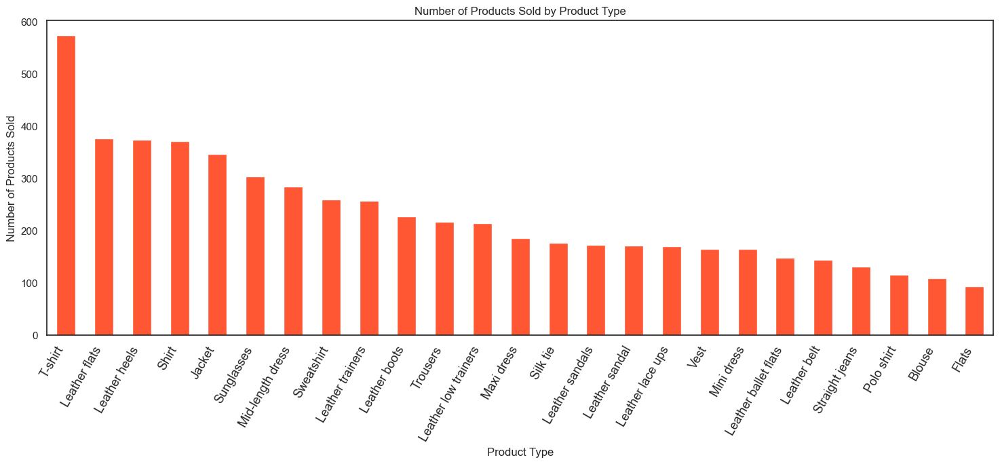

In [25]:
#Top 25 helps remove noisy variables
plt.figure(figsize=(18, 8))
plt.subplots_adjust(bottom=0.3)
sold_by_item = sold_item.nlargest(25)
sold_by_item.plot(kind='bar', color='#FF5733') 
plt.xlabel('Product Type')
plt.ylabel('Number of Products Sold')
plt.title('Number of Products Sold by Product Type')
plt.xticks(rotation=60, ha='right', fontsize=13)
plt.show()

In [26]:
sold_by_item.head(25)

product_type
T-shirt                 574
Leather flats           376
Leather heels           374
Shirt                   371
Jacket                  346
Sunglasses              303
Mid-length dress        284
Sweatshirt              259
Leather trainers        256
Leather boots           227
Trousers                216
Leather low trainers    214
Maxi dress              185
Silk tie                176
Leather sandals         172
Leather sandal          171
Leather lace ups        169
Vest                    165
Mini dress              164
Leather ballet flats    148
Leather belt            143
Straight jeans          130
Polo shirt              115
Blouse                  108
Flats                    93
Name: count, dtype: int64

In [27]:
product_material = sold_products['product_material'].value_counts()
product_material 

product_material
Leather          3971
Cotton           2841
Polyester         829
Silk              810
Wool              803
                 ... 
Silver Plated       1
Platinum            1
Raccoon             1
Sponge              1
Astrakhan           1
Name: count, Length: 61, dtype: int64

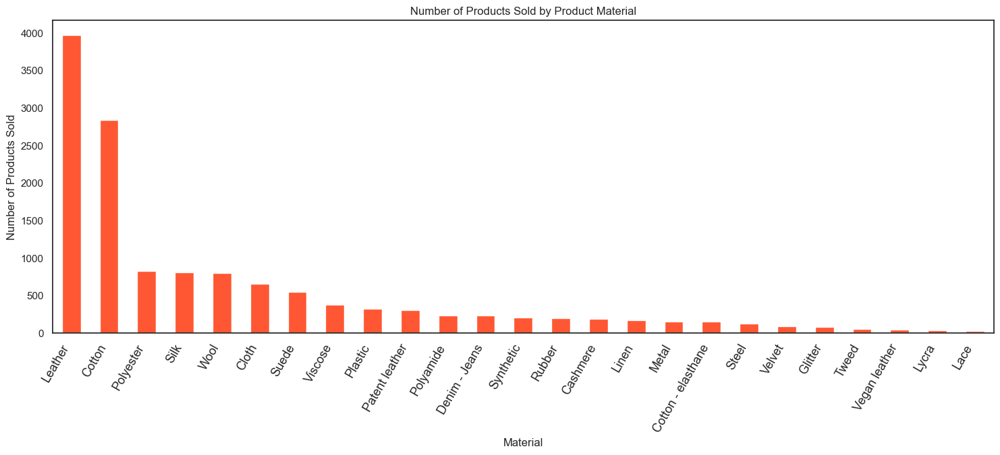

In [28]:
#same process for sold materials
plt.figure(figsize=(18, 8))
plt.subplots_adjust(bottom=0.3)
product_material = sold_products['product_material'].value_counts()
sold_by_material = product_material.nlargest(25)
sold_by_material.plot(kind='bar', color='#FF5733') 
plt.xlabel('Material')
plt.ylabel('Number of Products Sold')
plt.title('Number of Products Sold by Product Material')
plt.xticks(rotation=60, ha='right', fontsize=13)
plt.show()

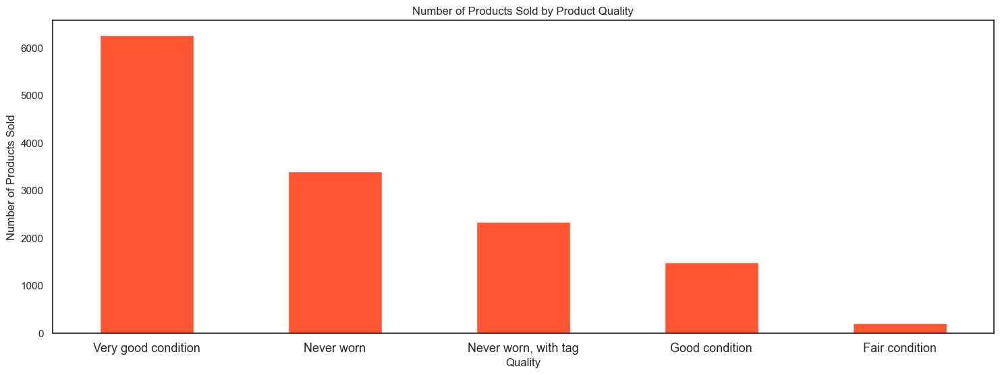

In [29]:
#same process for item quality
plt.figure(figsize=(18, 8))
plt.subplots_adjust(bottom=0.3)
product_condition = sold_products['product_condition'].value_counts()
sold_by_quality = product_condition.nlargest(25)
sold_by_quality.plot(kind='bar', color='#FF5733') 
plt.xlabel('Quality')
plt.ylabel('Number of Products Sold')
plt.title('Number of Products Sold by Product Quality')
plt.xticks(rotation=360, ha='center', fontsize=13)
plt.show()

In [30]:
sold_by_quality.head()

product_condition
Very good condition     6268
Never worn              3413
Never worn, with tag    2339
Good condition          1498
Fair condition           218
Name: count, dtype: int64

In [31]:
top_25_products = ['T-shirt', 'Leather flats', 'Leather heels', 'Shirt', 'Jacket',
       'Sunglasses', 'Mid-length dress', 'Sweatshirt', 'Leather trainers',
       'Leather boots', 'Trousers', 'Leather low trainers', 'Maxi dress',
       'Silk tie', 'Leather sandals', 'Leather sandal', 'Leather lace ups',
       'Vest', 'Mini dress', 'Leather ballet flats', 'Leather belt',
       'Straight jeans', 'Polo shirt', 'Blouse', 'Flats']


vestiaire_data['top_25_products'] = vestiaire_data['product_type'].isin(top_25_products).astype(int)

In [32]:
#creating a new data set with top brands, and top products
vestiaire_data.head()

,product_type,product_category,product_condition,product_like_count,sold,brand_id,brand_name,product_material,seller_price,buyers_fees,top_25_brand,top_25_products
0,Wool mini skirt,Women Clothing,Never worn,34.0,1,117,Miu Miu,Wool,223.65,NaN,1,0
1,Jacket,Women Clothing,Very good condition,1.0,0,161,Barbara Bui,Cotton,106.50,21.30,0,1
2,Wool coat,Women Clothing,Very good condition,2.0,0,391,Comme Des Garcons,Wool,1065.00,213.00,0,0
3,Mini skirt,Women Clothing,Very good condition,0.0,0,2797,MSGM,Polyester,149.00,14.90,0,0
4,Vegan leather trousers,Women Clothing,Very good condition,1.0,0,11956,LVIR,Vegan leather,99.77,19.95,0,0


In [33]:
vestiaire_data_bvp2 = vestiaire_data[~((vestiaire_data['top_25_brand'] == 0))]
vestiaire_data_bvp2.head()

,product_type,product_category,product_condition,product_like_count,sold,brand_id,brand_name,product_material,seller_price,buyers_fees,top_25_brand,top_25_products
0,Wool mini skirt,Women Clothing,Never worn,34.0,1,117,Miu Miu,Wool,223.65,NaN,1,0
9,Wool suit jacket,Women Clothing,Very good condition,2.0,1,10,Dior,Wool,358.91,NaN,1,0
15,Top,Women Clothing,Very good condition,2.0,0,94,Burberry,Cotton,64.97,12.99,1,0
19,Trousers,Women Clothing,Very good condition,4.0,1,2,Gucci,Cotton,119.44,NaN,1,1
23,Wool skirt suit,Women Clothing,Very good condition,0.0,0,88,Valentino Garavani,Wool,99.00,9.90,1,0


In [35]:
#found strategy from: https://sparkbyexamples.com/pandas/pandas-delete-rows-based-on-column-value/#:~:text=To%20delete%20rows%20based%20on%20specific%20column%20values%20in%20a,method%20to%20remove%20those%20rows.
#This new dataset only includes the products that are of top popularity, sold, and from popular brands
columns_to_clean = ['top_25_brand', 'top_25_products']
vestiaire_data_bvp1 = vestiaire_data[~((vestiaire_data[columns_to_clean[0]] == 0) & (vestiaire_data[columns_to_clean[1]] == 0))]
vestiaire_data_bvp1 = vestiaire_data_bvp2[~((vestiaire_data_bvp2[columns_to_clean[0]] == 1) & (vestiaire_data_bvp2[columns_to_clean[1]] == 0))]
vestiaire_data_bvp1 = vestiaire_data_bvp2[~((vestiaire_data_bvp2[columns_to_clean[0]] == 0) & (vestiaire_data_bvp2[columns_to_clean[1]] == 1))]
vestiaire_data_bvp1.head()

,product_type,product_category,product_condition,product_like_count,sold,brand_id,brand_name,product_material,seller_price,buyers_fees,top_25_brand,top_25_products
0,Wool mini skirt,Women Clothing,Never worn,34.0,1,117,Miu Miu,Wool,223.65,NaN,1,0
9,Wool suit jacket,Women Clothing,Very good condition,2.0,1,10,Dior,Wool,358.91,NaN,1,0
15,Top,Women Clothing,Very good condition,2.0,0,94,Burberry,Cotton,64.97,12.99,1,0
19,Trousers,Women Clothing,Very good condition,4.0,1,2,Gucci,Cotton,119.44,NaN,1,1
23,Wool skirt suit,Women Clothing,Very good condition,0.0,0,88,Valentino Garavani,Wool,99.00,9.90,1,0


In [36]:
#Rates for top companies to find what is more likely to sell

top_25_brands_inv = vestiaire_data['brand_name'].value_counts().nlargest(25)
top_25_brands_bvp2 = vestiaire_data_bvp1['brand_name'].count()

selling_rate_bvp = top_25_brands_bvp2 / top_25_brands_inv
selling_rate_bvp = selling_rate_bvp.reset_index(name='Selling Rate')

selling_rate_bvp = selling_rate_bvp.sort_values(by='Selling Rate', ascending=False)
selling_rate_bvp

,brand_name,Selling Rate
24,Celine,50.778815
23,Max Mara,50.595213
22,Tod's,50.438895
21,Salvatore Ferragamo,49.470875
20,Givenchy,46.371627
19,Dsquared2,46.037443
18,Yves Saint Laurent,43.489270
17,Bottega Veneta,42.767719
16,Christian Louboutin,37.424478
15,Polo Ralph Lauren,32.299077


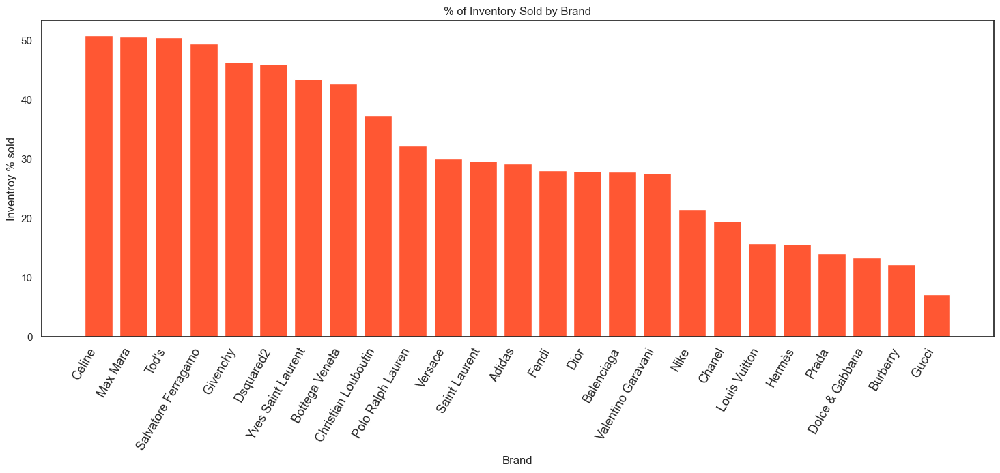

In [37]:
plt.figure(figsize=(18, 8))
plt.subplots_adjust(bottom=0.3)
selling_rate_bvp = selling_rate_bvp.sort_values(by='Selling Rate', ascending=False)
plt.bar(selling_rate_bvp['brand_name'], selling_rate_bvp['Selling Rate'], color='#FF5733')
plt.xlabel('Brand')
plt.ylabel('Inventroy % sold')
plt.title('% of Inventory Sold by Brand')
plt.xticks(rotation=60, ha='right', fontsize=13)
plt.show()

In [38]:
#repeat with product type
top_25_product_inv = vestiaire_data['product_type'].value_counts().nlargest(25)
top_25_product_bvp2 = vestiaire_data_bvp1['product_type'].count()

selling_rate_bvp = top_25_product_bvp2 / top_25_product_inv
selling_rate_bvp = selling_rate_bvp.reset_index(name='selling_rate')

selling_rate_bvp = selling_rate_bvp.sort_values(by='selling_rate', ascending=False)
selling_rate_bvp

,product_type,selling_rate
24,Wool coat,40.627264
23,Pull,40.610420
22,Boots,39.969668
21,Straight jeans,38.123638
20,Low trainers,37.093789
19,Hat,36.916709
18,Mini dress,29.190126
17,Leather wallet,23.042186
16,Leather trainers,22.428408
15,Vest,21.283190


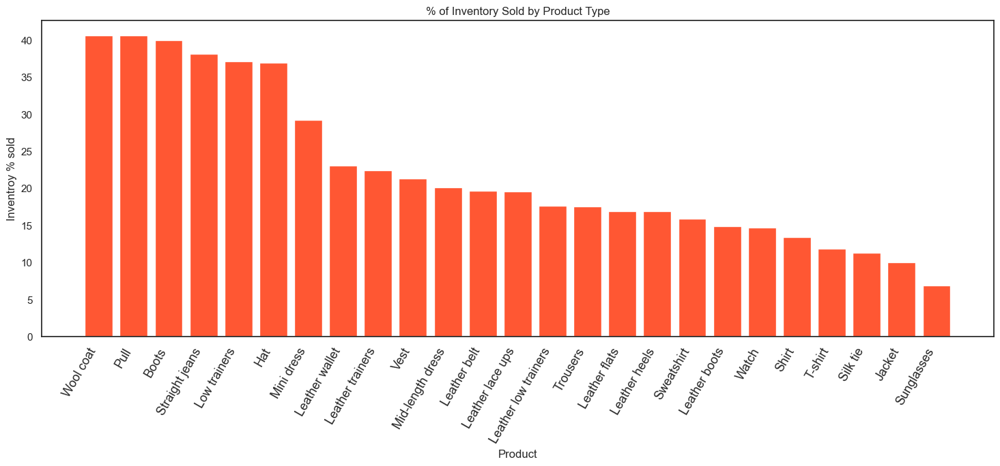

In [39]:
plt.figure(figsize=(18, 8))
plt.subplots_adjust(bottom=0.3)
selling_rate_bvp = selling_rate_bvp.sort_values(by='selling_rate', ascending=False)
plt.bar(selling_rate_bvp['product_type'], selling_rate_bvp['selling_rate'], color='#FF5733')
plt.xlabel('Product')
plt.ylabel('Inventroy % sold')
plt.title('% of Inventory Sold by Product Type')
plt.xticks(rotation=60, ha='right', fontsize=13)
plt.show()

In [40]:
#repeat with materials this time
top_25_materials_inv = vestiaire_data['product_material'].value_counts().nlargest(25)
top_25_materials_bvp2 = vestiaire_data_bvp1['product_material'].count()

selling_rate_bvp = top_25_materials_bvp2 / top_25_materials_inv
selling_rate_bvp = selling_rate_bvp.reset_index(name='selling_rate')

selling_rate_bvp = selling_rate_bvp.sort_values(by='selling_rate', ascending=False)
selling_rate_bvp

,product_material,selling_rate
24,Silver,122.644825
23,Fur,108.154950
22,Vegan leather,98.345716
21,Glitter,84.175594
20,Velvet,55.866350
19,Linen,43.905125
18,Not specified,41.260461
17,Cotton - elasthane,38.762300
16,Denim - Jeans,30.838178
15,Rubber,29.827142


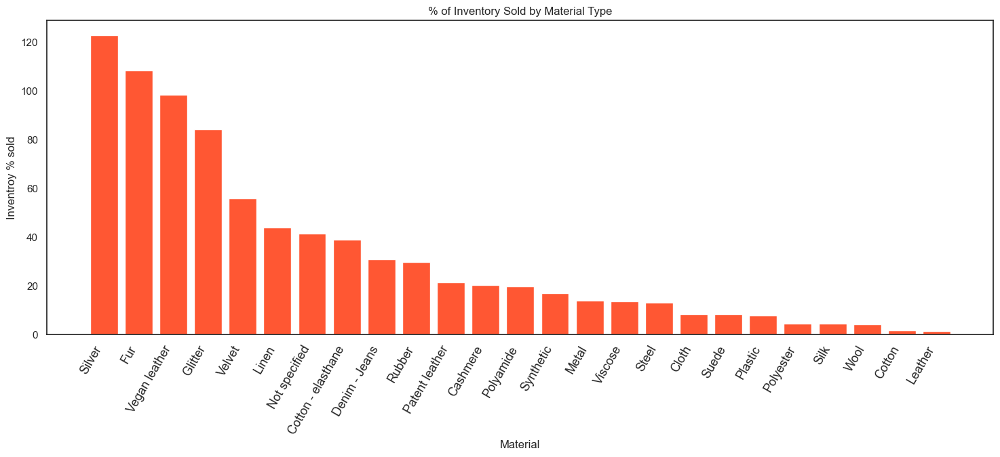

In [41]:
plt.figure(figsize=(18, 8))
plt.subplots_adjust(bottom=0.3)
selling_rate_bvp = selling_rate_bvp.sort_values(by='selling_rate', ascending=False)
plt.bar(selling_rate_bvp['product_material'], selling_rate_bvp['selling_rate'], color='#FF5733')
plt.xlabel('Material')
plt.ylabel('Inventroy % sold')
plt.title('% of Inventory Sold by Material Type')
plt.xticks(rotation=60, ha='right', fontsize=13)
plt.show()

In [42]:
#Repeat last time with Quality
condition_inv = vestiaire_data['product_condition'].value_counts().nlargest(25)
contdition_bvp2 = vestiaire_data_bvp1['product_condition'].count()

selling_rate_bvp = contdition_bvp2 / condition_inv
selling_rate_bvp = selling_rate_bvp.reset_index(name='selling_rate')

selling_rate_bvp = selling_rate_bvp.sort_values(by='selling_rate', ascending=False)
selling_rate_bvp

,product_condition,selling_rate
4,Fair condition,12.049246
3,"Never worn, with tag",2.386714
2,Good condition,2.250984
1,Never worn,1.327771
0,Very good condition,0.732551


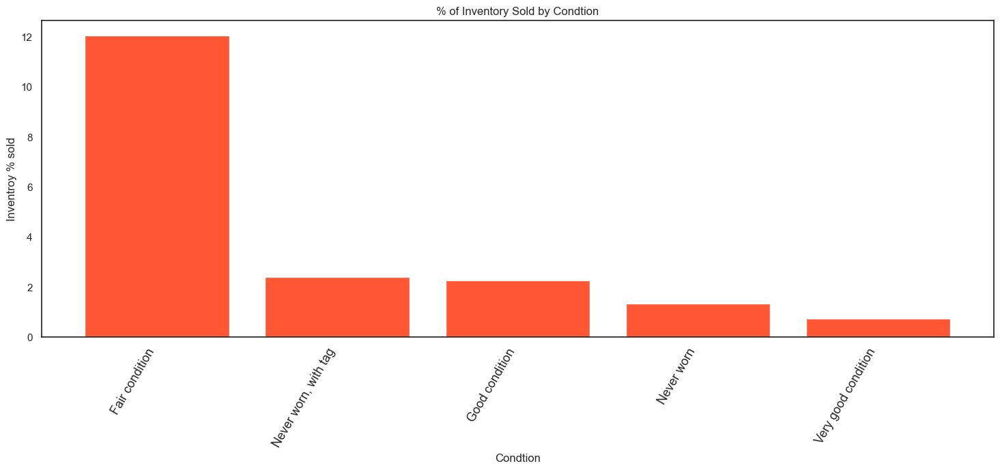

In [43]:
plt.figure(figsize=(18, 8))
plt.subplots_adjust(bottom=0.3)
selling_rate_bvp = selling_rate_bvp.sort_values(by='selling_rate', ascending=False)
plt.bar(selling_rate_bvp['product_condition'], selling_rate_bvp['selling_rate'], color='#FF5733')
plt.xlabel('Condtion')
plt.ylabel('Inventroy % sold')
plt.title('% of Inventory Sold by Condtion')
plt.xticks(rotation=60, ha='right', fontsize=13)
plt.show()

In [45]:
brand_product_pref = vestiaire_data_bvp1.groupby(['brand_name','product_type']).size()
table_bbyp = brand_product_pref.unstack(fill_value = 0)

table_bbyp

product_type,leather,"""Z"" Trainer CT-01 leather high trainers","""Z"" Trainer CT-01 leather low trainers","""Z"" Trainer CT-01 leather trainers",1.1 Millionnaires sunglasses,123 Run cloth trainers,1973 leather belt,2.12 glitter trainers,2.12 high trainers,2.12 leather high trainers,2.12 leather low trainers,2.12 leather trainers,2.55 leather card wallet,2.55 leather clutch,2.55 leather purse,2.55 leather wallet,2.55 patent leather purse,2.55 patent leather wallet,2.55 purse,2.55 wallet,24 leather purse,251 cloth low trainers,251 high trainers,251 leather high trainers,251 leather low trainers,251 leather trainers,251 low trainers,251 patent leather high trainers,251 patent leather low trainers,251 vegan leather high trainers,30 Montaigne card wallet,30 Montaigne cloth belt,30 Montaigne cloth card wallet,30 Montaigne cloth purse,30 Montaigne cloth wallet,30 Montaigne exotic leathers belt,30 Montaigne leather belt,30 Montaigne leather flip flops,30 Montaigne leather mules,30 Montaigne leather purse,30 Montaigne leather sandal,30 Montaigne leather wallet,30 Montaigne linen wallet,30 Montaigne patent leather card wallet,30 Montaigne patent leather purse,30 Montaigne purse,30 Montaigne wallet,30Montaigne goggle glasses,30Montaigne oversized sunglasses,30Montaigne sunglasses,30Montaigne1 aviator sunglasses,30Montaigne1 oversized sunglasses,30Montaigne1 sunglasses,30Montaigne2 oversized sunglasses,30Montaigne2 sunglasses,3XL cloth low trainers,3XL cloth trainers,3XL leather low trainers,3XL low trainers,3XL trainers,551 cloth low trainers,551 high trainers,551 leather low trainers,551 low trainers,Abbey velvet riding boots,Abstract aviator sunglasses,Abstract oversized sunglasses,Abstract sunglasses,Academy cloth flats,Academy leather boots,Academy leather flats,Academy leather flip flops,Academy patent leather flats,Accessories,Ace alligator low trainers,Ace cloth high trainers,Ace cloth low trainers,Ace cloth trainers,Ace exotic leathers high trainers,Ace exotic leathers trainers,Ace faux fur trainers,Ace glitter low trainers,Ace glitter trainers,Ace leather high trainers,Ace leather low trainers,Ace leather trainers,Ace low trainers,Ace patent leather high trainers,Ace patent leather low trainers,Ace patent leather trainers,Ace python low trainers,Ace trainers,Ace vegan leather high trainers,Ace vegan leather low trainers,Ace velvet trainers,Ace vinyl low trainers,Addict cloth trainers,Addict trainers,Addict tweed trainers,Adilette cloth flip flops,Adilette cloth low trainers,Adilette cloth mules & clogs,Adilette cloth sandals,Adilette cloth trainers,Adilette flats,Adilette flip flops,Adilette low trainers,Adilette mules,Adilette sandal,Adilette sandals,Adilette vinyl mules,Adilette vinyl sandals,Adèle cloth purse,Adèle cloth wallet,Adèle leather purse,Adèle leather wallet,Adèle wallet,Aftergame cloth trainers,Aftergame leather trainers,Aguru Crystal cloth sandals,Aguru Crystal leather sandal,Albatorock leather trainers,Alexandra cloth wallet,Alexandra leather wallet,Alexandra patent leather wallet,Alexandra wallet,Alligator ballet flats,Alligator belt,Alligator boots,Alligator card wallet,Alligator clutch,Alligator espadrilles,Alligator flats,Alligator heels,Alligator high trainers,Alligator jewellery,Alligator key ring,Alligator lace ups,Alligator low trainers,Alligator purse,Alligator sandal,Alligator sandals,Alligator trainers,Alligator wallet,Alligator watch,Almond heels,Almond leather heels,Almond patent leather heels,Aloha flip flops,Aloha leather mules,Aloha leather sandal,Aloha mules,Aloha sandal,Alphabet LV&ME jewellery,Alphabet LV&ME leather jewellery,Alésia leather sandals,Amber glitter sandal,Amber leather sandal,Amber sandal,Amber sandals,Anaé cloth key ring,Anaé leather key ring,Anaé leather purse,Andy cloth high trainers,Andy cloth low trainers,Andy cloth trainers,Andy leather low trainers,Andy leather trainers,Andy python low trainers,Andy trainers,Andy velvet trainers,Anja alligator heels,Anja cloth heels,Anja 

In [46]:
#want the stacked bar chart to show the most popular items on the bottom, and least on top
total_count_by_product_type = table_bbyp.sum(axis=0)
sorted_columns = total_count_by_product_type.sort_values(ascending=False).index
table_bbyp.sort_values(by='T-shirt', ascending=False, inplace=True)
table_bbyp = table_bbyp[sorted_columns]

table_bbyp

product_type,Sunglasses,Silk tie,Leather heels,Leather wallet,Leather flats,Leather boots,Jacket,T-shirt,Leather belt,Shirt,Leather low trainers,Leather trainers,Leather lace ups,Sweatshirt,Oversized sunglasses,Silk scarf,Trousers,Vest,Leather purse,Silk neckerchief,Hat,Wool scarf,Silk handkerchief,Leather sandal,Leather sandals,Patent leather heels,Pull,Heels,Leather high trainers,Sandals,Polo shirt,Trainers,Boots,Wool coat,Watch,Wool scarf & pocket square,Mid-length dress,Straight jeans,Wool pull,Low trainers,Cloth wallet,Wool jacket,Flats,Cloth low trainers,Cashmere scarf,Cloth heels,Cloth trainers,Slim jean,Aviator sunglasses,Coat,Carré 90 silk silk handkerchief,Puffer,Leather jacket,Trench,Purse,Mini dress,Wool hat,Goggle glasses,Leather ballet flats,Leather mules & clogs,Belt,Wool vest,Wool trousers,Cloth purse,Scarf,Leather ankle boots,Jeans,Silk scarf & pocket square,Cloth belt,Wallet,Leather espadrilles,Wool beanie,Trench coat,Top,Sandal,Silk shirt,Wool jumper,Cashmere scarf & pocket square,Mid-length skirt,Swimwear,Blouse,Silk mid-length dress,Leather biker boots,Cloth sandal,Scarf & pocket square,Ace leather low trainers,Leather gloves,Leather card wallet,Cloth espadrilles,Wool suit,Silk blouse,Mini skirt,Patent leather sandal,Leather mules,Lace ups,Cloth flats,Jewellery,Patent leather flats,Knitwear & sweatshirt,Dress,Leather key ring,Cloth boots,Jumper,Cap,Wool blazer,Suit,High trainers,Cloth sandals,Short,GG Buckle leather belt,Silk stole,Trenchcoat,Cloth high trainers,Wool sweatshirt,Patent leather wallet,Blazer,Superstar leather trainers,Straight pants,Short vest,Wool cardigan,Chypre leather sandals,Cashmere jumper,Cloth hat,Cashmere pull,Leather riding boots,Wool mid-length dress,Oversize leather low trainers,One-piece swimsuit,Velvet flats,Leather biker jacket,Silk mini dress,Cashmere cardigan,Cardigan,Ankle boots,Glitter heels,Leather jewellery,Slim jeans,Ace leather trainers,Interlocking Buckle leather belt,Wool mid-length skirt,Leather vest,Oversize leather trainers,Twilly 86 silk scarf,Chypre leather sandal,Neckerchief,Samba leather trainers,Cashmere stole,Wool knitwear & sweatshirt,Patent leather boots,Silver jewellery,Rhyton leather low trainers,Parka,Patent leather lace ups,Espadrilles,Bermuda,Intrecciato leather wallet,Rockstud leather heels,Shorts,Silk choker,Maxi dress,Patent leather sandals,Two-piece swimsuit,Patent leather belt,Velvet heels,Jordaan leather flats,Cloth lace ups,Mules & clogs,Cashmere coat,Wool stole,Tie,Cufflinks,Superstar leather low trainers,Silk mid-length skirt,Cloth mules & clogs,Tweed jacket,Wool knitwear,Timeless/Classique leather wallet,H leather belt,Knitwear,Wool mini skirt,Leather coat,Cashmere beanie,LV Trainer leather low trainers,Gloves,Mules,Gazelle trainers,Leggings,Brixton leather flats,Portofino leather low trainers,Leather hat,Patent leather ballet flats,Rockstud leather low trainers,Louis leather high trainers,Cloth ballet flats,Medusa leather belt,Silk maxi dress,Zippy leather wallet,Leather flip flops,Skirt,So Kate patent leather heels,Wool mini dress,Silk jacket,Jumpsuit,Wool gloves,Stole,Python heels,Silk dress,Wellington boots,Wool dufflecoat,Mini short,Cashmere hat,Princetown leather flats,Patent leather trainers,Speed cloth trainers,Polo,Cloth mules,Camisole,Oran leather sandal,So Kate leather heels,Triple S cloth trainers,Rockrunner leather low trainers,Wool dress,Patent leather purse,Oversize leather high trainers,Ballet flats,Corset,Flip flops,Wool peacoat,Wool straight pants,Rockstud patent leather heels,Chypre leather mules,Peacoat,Slim pants,Large pants,Silk trousers,Triple S leather trainers,Rockstud leather trainers,Leather clutch,Oran leather mules,Jersey top,Medusa Aevitas cloth heels,Wool cap,Rhyton leather trainers,Medusa Biggie sunglasses,Wool short vest,Pigalle patent leather heels,Speed trainers,Patent leather low trainers,Lug leather boots,Leather cowboy boots,Key ring,Silk vest,Sarah leather wallet,G-Timeless watch,Triple S trainers,Initi

In [50]:
#I wanted a visual to emphasize during my presentation how many factors there are to consider in fashion, which is why the bars are very busy
fig, ax = plt.subplots(figsize=(8, 15))
table_bbyp.plot(ax=ax, kind="bar", stacked=True)

plt.xlabel("Brand")
plt.ylabel("Number Sold")
plt.title("Product Preference By brand")--> 398     self.renderer = RendererAgg(w, h, self.figure.dpi)
    399     self._lastKey = key
    400 return self.renderer

File /opt/anaconda3/lib/python3.12/site-packages/matplotlib/backends/backend_agg.py:70, in RendererAgg.__init__(self, width, height, dpi)
     68 self.width = width
     69 self.height = height
---> 70 self._renderer = _RendererAgg(int(width), int(height), dpi)
     71 self._filter_renderers = []
     73 self._update_methods()

ValueError: Image size of 716x132463 pixels is too large. It must be less than 2^16 in each direction.
<Figure size 800x1500 with 1 Axes>

plt.legend(title="Product Type")

plt.show()

/opt/anaconda3/lib/python3.12/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


ValueError: Image size of 716x132463 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 800x1500 with 1 Axes>

In [48]:
#I wanted more variety in my graphing as i mostly have categorical or boolean data: https://www.geeksforgeeks.org/how-to-create-pie-chart-from-pandas-dataframe/
#legend: https://matplotlib.org/stable/users/explain/axes/legend_guide.html
vestiaire_data_bvp.groupby(['product_category']).sum().plot(kind='pie', y='sold')
plt.legend(loc="center left", bbox_to_anchor=(0.9, .39), title="Product Category")

NameError: name 'vestiaire_data_bvp' is not defined

In [ ]:
#2. Target pricing and Audience class

In [ ]:
vestiaire_data.head()

In [ ]:
item_price = vestiaire_data_bvp.groupby(['product_type'])['seller_price'].median().reset_index()
item_price = item_price.sort_values(by='seller_price', ascending=False)

fig, ax = plt.subplots(figsize=(13, 6))
ax.bar(item_price['product_type'], item_price['seller_price'], color='#FF5733')
ax.set_title('Median Prices for Sold Items by Item Type', fontsize=24)
ax.set_xlabel('Product Type')
ax.set_ylabel('Median Price (Euro)')

plt.xticks(rotation=45, ha='right')

plt.show()


In [ ]:
item_price.head(25)

In [ ]:
quality_price = vestiaire_data_bvp.groupby(['product_condition'])['seller_price'].median().reset_index()
quality_price = quality_price.sort_values(by='seller_price', ascending=False)

fig, ax = plt.subplots(figsize=(13, 6))
ax.bar(quality_price['product_condition'], quality_price['seller_price'], color='#FF5733')
ax.set_title('Median Prices for Sold Items by Product Quality', fontsize=24)
ax.set_xlabel('Product Quality')
ax.set_ylabel('Median Price (Euro)')

plt.xticks(rotation=45, ha='right')

plt.show()

In [ ]:
quality_price.head()

In [ ]:
#I wanted to see the like count to price -- to gauge customer interest, but the outliers disrupt the interpretation
vc = vestiaire_data_bvp.loc[vestiaire_data_bvp["product_like_count"] != 0, :]

vc[["product_like_count", "seller_price"]].corr()

plt.figure(figsize=(5, 5))
ax = plt.axes()
ax.scatter(vestiaire_data_bvp["product_like_count"], vestiaire_data_bvp["seller_price"], color='#FF5733', alpha=0.20)
ax.set_xlabel('product_like_count')
ax.set_ylabel('seller_price') 
plt.show()

In [ ]:
# used strategy from: https://stackoverflow.com/questions/71106128/remove-outlier-using-quantile-python
like_count = vestiaire_data_bvp['product_like_count'].quantile(0.95)
price = vestiaire_data_bvp['seller_price'].quantile(0.95)

narrowed_data = vestiaire_data_bvp[
    (vestiaire_data_bvp['product_like_count'] <= like_count) & 
    (vestiaire_data_bvp['seller_price'] <= price)
]

plt.figure(figsize=(8, 8))
ax = plt.axes()
ax.scatter(narrowed_data["product_like_count"], narrowed_data["seller_price"], color='#FF5733', alpha=0.20)
ax.set_xlabel('product_like_count')
ax.set_ylabel('seller_price')
plt.show()


In [ ]:
#This is of all products listed, mostly for visual emphasis -- to show what vestiaire offers vs what is actually bought
vc = vestiaire_data.loc[vestiaire_data["product_like_count"] != 0, :]

vc[["product_like_count", "seller_price"]].corr()

plt.figure(figsize=(5, 5))
ax = plt.axes()
ax.scatter(vestiaire_data["product_like_count"], vestiaire_data["seller_price"], color='#FF5733', alpha=0.20)
ax.set_xlabel('product_like_count')
ax.set_ylabel('seller_price') 
plt.show()

In [ ]:
like_count = vestiaire_data['product_like_count'].quantile(0.95)
price = vestiaire_data['seller_price'].quantile(0.95)

narrowed_data = vestiaire_data[
    (vestiaire_data['product_like_count'] <= like_count) & 
    (vestiaire_data['seller_price'] <= price)
]

plt.figure(figsize=(8, 8))
ax = plt.axes()
ax.scatter(narrowed_data["product_like_count"], narrowed_data["seller_price"], color='#FF5733', alpha=0.20)
ax.set_xlabel('product_like_count')
ax.set_ylabel('seller_price')
plt.show()

In [ ]:
#End